In [24]:
# Importing the required libraries

import json
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import os

In [25]:
def read_json_2df(filename):
    with open(filename) as f:
        data = json.load(f)
    return data


In [26]:
desktop_dict = read_json_2df("dino_monthly_desktop_201507-202209.json")



mobile_dict = read_json_2df("dino_monthly_mobile_201507-202209.json")



cumulative_dict = read_json_2df("dino_monthly_cumulative_201507-202209.json")

In [23]:
desktop_dict

{'Aachenosaurus': [{'project': 'en.wikipedia',
   'article': 'Aachenosaurus',
   'granularity': 'monthly',
   'timestamp': '2015070100',
   'access': 'desktop',
   'agent': 'user',
   'views': 2671},
  {'project': 'en.wikipedia',
   'article': 'Aachenosaurus',
   'granularity': 'monthly',
   'timestamp': '2015080100',
   'access': 'desktop',
   'agent': 'user',
   'views': 13113},
  {'project': 'en.wikipedia',
   'article': 'Aachenosaurus',
   'granularity': 'monthly',
   'timestamp': '2015090100',
   'access': 'desktop',
   'agent': 'user',
   'views': 34235},
  {'project': 'en.wikipedia',
   'article': 'Aachenosaurus',
   'granularity': 'monthly',
   'timestamp': '2015100100',
   'access': 'desktop',
   'agent': 'user',
   'views': 5361},
  {'project': 'en.wikipedia',
   'article': 'Aachenosaurus',
   'granularity': 'monthly',
   'timestamp': '2015110100',
   'access': 'desktop',
   'agent': 'user',
   'views': 13502},
  {'project': 'en.wikipedia',
   'article': 'Aachenosaurus',
   '

In [59]:
desktop_list = []

for key in desktop_dict:
    for val in desktop_dict[key]:
        desktop_list.append(val)
        
desktop_dataframe_all = pd.DataFrame.from_dict(desktop_list)

In [60]:
desktop_dataframe_all

,project,article,granularity,timestamp,access,agent,views
0,en.wikipedia,Aachenosaurus,monthly,2015070100,desktop,user,2671
1,en.wikipedia,Aachenosaurus,monthly,2015080100,desktop,user,13113
2,en.wikipedia,Aachenosaurus,monthly,2015090100,desktop,user,34235
3,en.wikipedia,Aachenosaurus,monthly,2015100100,desktop,user,5361
4,en.wikipedia,Aachenosaurus,monthly,2015110100,desktop,user,13502
...,...,...,...,...,...,...,...
112605,en.wikipedia,Zuul,monthly,2022050100,desktop,user,1091
112606,en.wikipedia,Zuul,monthly,2022060100,desktop,user,903
112607,en.wikipedia,Zuul,monthly,2022070100,desktop,user,1267
112608,en.wikipedia,Zuul,monthly,2022080100,desktop,user,985


In [61]:
# Creating mobile dataframe
mobile_list = []

for key in mobile_dict:
    for val in mobile_dict[key]:
        mobile_list.append(val)
        
mobile_dataframe_all = pd.DataFrame.from_dict(mobile_list)


In [107]:
mobile_dataframe_all

,project,article,granularity,timestamp,access,agent,views
0,en.wikipedia,Aachenosaurus,monthly,2015070100,combined mobile,user,443
1,en.wikipedia,Aachenosaurus,monthly,2015080100,combined mobile,user,412
2,en.wikipedia,Aachenosaurus,monthly,2015090100,combined mobile,user,283
3,en.wikipedia,Aachenosaurus,monthly,2015100100,combined mobile,user,794
4,en.wikipedia,Aachenosaurus,monthly,2015110100,combined mobile,user,311
...,...,...,...,...,...,...,...
112605,en.wikipedia,Zuul,monthly,2022050100,combined mobile,user,1005
112606,en.wikipedia,Zuul,monthly,2022060100,combined mobile,user,937
112607,en.wikipedia,Zuul,monthly,2022070100,combined mobile,user,1526
112608,en.wikipedia,Zuul,monthly,2022080100,combined mobile,user,1233


### Graph A: Maximum Average and Minimum Average Pageviews for desktop and mobile

In [74]:
## Step 1: Dinosaur articles with total lowest and highest average page request (views) for desktop and mobile access
## Grouping by article title to calculate averages and then sorting by views in descending order

desktop_dataframe = desktop_dataframe_all.groupby('article').mean().reset_index().sort_values('views', ascending = False)

mobile_dataframe = mobile_dataframe_all.groupby('article').mean().reset_index().sort_values('views', ascending = False)

In [75]:
desktop_dataframe_all

,project,article,granularity,timestamp,access,agent,views
0,en.wikipedia,Aachenosaurus,monthly,2015070100,desktop,user,2671
1,en.wikipedia,Aachenosaurus,monthly,2015080100,desktop,user,13113
2,en.wikipedia,Aachenosaurus,monthly,2015090100,desktop,user,34235
3,en.wikipedia,Aachenosaurus,monthly,2015100100,desktop,user,5361
4,en.wikipedia,Aachenosaurus,monthly,2015110100,desktop,user,13502
...,...,...,...,...,...,...,...
112605,en.wikipedia,Zuul,monthly,2022050100,desktop,user,1091
112606,en.wikipedia,Zuul,monthly,2022060100,desktop,user,903
112607,en.wikipedia,Zuul,monthly,2022070100,desktop,user,1267
112608,en.wikipedia,Zuul,monthly,2022080100,desktop,user,985


In [79]:
#Step 1: Getting max and min avgviews dino names
desktop_dino_max_avgviews = list(desktop_dataframe.article)[0]
desktop_dino_min_avgviews = list(desktop_dataframe.article)[-1]

mobile_dino_max_avgviews = list(mobile_dataframe.article)[0]
mobile_dino_min_avgviews = list(mobile_dataframe.article)[-1]

In [84]:
# Step 2: Using 'desktop_dino_max_avgviews' for filtering the dataframe

desktop_dataframe_maxmin = desktop_dataframe_all[desktop_dataframe_all['article'].isin([desktop_dino_max_avgviews,desktop_dino_min_avgviews])]
mobile_dataframe_maxmin = mobile_dataframe_all[mobile_dataframe_all['article'].isin([mobile_dino_max_avgviews, mobile_dino_min_avgviews])]

In [86]:
mobile_dataframe_maxmin

,project,article,granularity,timestamp,access,agent,views
45161,en.wikipedia,Honghesaurus,monthly,2015070100,combined mobile,user,6
45162,en.wikipedia,Honghesaurus,monthly,2015080100,combined mobile,user,5
45163,en.wikipedia,Honghesaurus,monthly,2015090100,combined mobile,user,2
45164,en.wikipedia,Honghesaurus,monthly,2015100100,combined mobile,user,1
45165,en.wikipedia,Honghesaurus,monthly,2015110100,combined mobile,user,3
...,...,...,...,...,...,...,...
103267,en.wikipedia,Tyrannosaurus,monthly,2022050100,combined mobile,user,68130
103268,en.wikipedia,Tyrannosaurus,monthly,2022060100,combined mobile,user,116521
103269,en.wikipedia,Tyrannosaurus,monthly,2022070100,combined mobile,user,88247
103270,en.wikipedia,Tyrannosaurus,monthly,2022080100,combined mobile,user,72021


In [85]:
desktop_dataframe_maxmin

,project,article,granularity,timestamp,access,agent,views
45161,en.wikipedia,Honghesaurus,monthly,2015070100,desktop,user,23
45162,en.wikipedia,Honghesaurus,monthly,2015080100,desktop,user,13
45163,en.wikipedia,Honghesaurus,monthly,2015090100,desktop,user,27
45164,en.wikipedia,Honghesaurus,monthly,2015100100,desktop,user,16
45165,en.wikipedia,Honghesaurus,monthly,2015110100,desktop,user,10
...,...,...,...,...,...,...,...
103267,en.wikipedia,Tyrannosaurus,monthly,2022050100,desktop,user,48438
103268,en.wikipedia,Tyrannosaurus,monthly,2022060100,desktop,user,58017
103269,en.wikipedia,Tyrannosaurus,monthly,2022070100,desktop,user,46505
103270,en.wikipedia,Tyrannosaurus,monthly,2022080100,desktop,user,38432


In [87]:
desktop_mobile_df = pd.concat([desktop_dataframe_maxmin, mobile_dataframe_maxmin])

In [89]:
desktop_mobile_df['label'] = desktop_mobile_df['article'].astype(str) + '-' + desktop_mobile_df['access'].astype(str)

In [93]:
desktop_mobile_df = desktop_mobile_df.reset_index()

In [94]:
desktop_mobile_df

,level_0,index,project,article,granularity,timestamp,access,agent,views,label
0,0,45161,en.wikipedia,Honghesaurus,monthly,2015070100,desktop,user,23,Honghesaurus-desktop
1,1,45162,en.wikipedia,Honghesaurus,monthly,2015080100,desktop,user,13,Honghesaurus-desktop
2,2,45163,en.wikipedia,Honghesaurus,monthly,2015090100,desktop,user,27,Honghesaurus-desktop
3,3,45164,en.wikipedia,Honghesaurus,monthly,2015100100,desktop,user,16,Honghesaurus-desktop
4,4,45165,en.wikipedia,Honghesaurus,monthly,2015110100,desktop,user,10,Honghesaurus-desktop
...,...,...,...,...,...,...,...,...,...,...
343,343,103267,en.wikipedia,Tyrannosaurus,monthly,2022050100,combined mobile,user,68130,Tyrannosaurus-combined mobile
344,344,103268,en.wikipedia,Tyrannosaurus,monthly,2022060100,combined mobile,user,116521,Tyrannosaurus-combined mobile
345,345,103269,en.wikipedia,Tyrannosaurus,monthly,2022070100,combined mobile,user,88247,Tyrannosaurus-combined mobile
346,346,103270,en.wikipedia,Tyrannosaurus,monthly,2022080100,combined mobile,user,72021,Tyrannosaurus-combined mobile


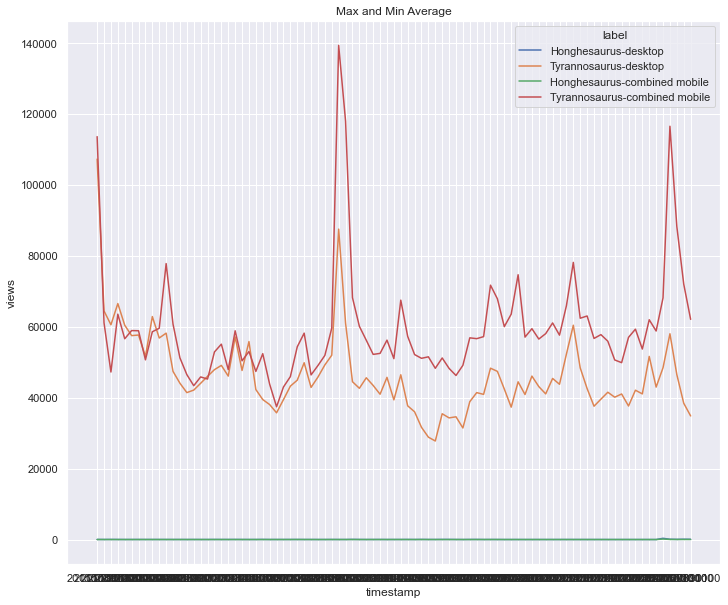

In [174]:
## Plotting the graph with 'label' as hue to distinguish between the four graph lines

sns.set(rc={'figure.figsize':(11.7,10)})
graph_1 = sns.lineplot(data= desktop_mobile_df, x = 'timestamp', y= 'views', hue= 'label').set_title('Max and Min Average')


graph_1 = graph_1.get_figure()
graph_1.savefig(os.path.join('.', 'graphs', 'Max_Min_Avg.png'))

### Graph B: Top 10 Peak Page Views

In [120]:
# Step 1: We will again group by dino name but aggregate by max rather than average

mobile_list_2 = list(mobile_dataframe_all.groupby('article').max().reset_index().sort_values('views', ascending = False)[:10]['article'])

In [121]:
mobile_list_2

['Nigersaurus',
 'Deinocheirus',
 'Giganotosaurus',
 'Therizinosaurus',
 'Velociraptor',
 'Achelousaurus',
 'Tyrannosaurus',
 'Borealopelta',
 'Dilophosaurus',
 'Argentinosaurus']

In [122]:
mobile_top_10_all_time_df = mobile_dataframe_all[mobile_dataframe_all['article'].isin(mobile_list_2)]

In [123]:
mobile_top_10_all_time_df['access'] = 'mobile'

/var/folders/jx/zmvdb9015r5cmfk2_vpyps180000gn/T/ipykernel_62736/1424129994.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  mobile_top_10_all_time_df['access'] = 'mobile'


In [124]:
mobile_top_10_all_time_df

,project,article,granularity,timestamp,access,agent,views
701,en.wikipedia,Achelousaurus,monthly,2015070100,mobile,user,464
702,en.wikipedia,Achelousaurus,monthly,2015080100,mobile,user,321
703,en.wikipedia,Achelousaurus,monthly,2015090100,mobile,user,301
704,en.wikipedia,Achelousaurus,monthly,2015100100,mobile,user,322
705,en.wikipedia,Achelousaurus,monthly,2015110100,mobile,user,325
...,...,...,...,...,...,...,...
105157,en.wikipedia,Velociraptor,monthly,2022050100,mobile,user,45282
105158,en.wikipedia,Velociraptor,monthly,2022060100,mobile,user,75803
105159,en.wikipedia,Velociraptor,monthly,2022070100,mobile,user,46600
105160,en.wikipedia,Velociraptor,monthly,2022080100,mobile,user,34763


In [125]:
desktop_list_2 = list(desktop_dataframe_all.groupby('article').max().reset_index().sort_values('views', ascending = False)[:10]['article'])

In [126]:
desktop_list_2

['Achelousaurus',
 'Velociraptor',
 'Tyrannosaurus',
 'Halszkaraptor',
 'Giganotosaurus',
 'Spinosaurus',
 'Lythronax',
 'Nigersaurus',
 'Borealopelta',
 'Dilophosaurus']

In [127]:
desktop_top_10_all_time_df = desktop_dataframe_all[desktop_dataframe_all['article'].isin(desktop_list_2)]

In [128]:
desktop_top_10_all_time_df

,project,article,granularity,timestamp,access,agent,views
701,en.wikipedia,Achelousaurus,monthly,2015070100,desktop,user,1181
702,en.wikipedia,Achelousaurus,monthly,2015080100,desktop,user,703
703,en.wikipedia,Achelousaurus,monthly,2015090100,desktop,user,699
704,en.wikipedia,Achelousaurus,monthly,2015100100,desktop,user,708
705,en.wikipedia,Achelousaurus,monthly,2015110100,desktop,user,691
...,...,...,...,...,...,...,...
105157,en.wikipedia,Velociraptor,monthly,2022050100,desktop,user,25219
105158,en.wikipedia,Velociraptor,monthly,2022060100,desktop,user,31520
105159,en.wikipedia,Velociraptor,monthly,2022070100,desktop,user,20092
105160,en.wikipedia,Velociraptor,monthly,2022080100,desktop,user,16691


In [129]:
desktop_mobile_top_all_time_df = pd.concat([mobile_top_10_all_time_df, desktop_top_10_all_time_df])

In [144]:
desktop_mobile_top_all_time_df = desktop_mobile_top_all_time_df[['timestamp','access', 'views', 'article']]

In [152]:
desktop_mobile_top_all_time_df = desktop_mobile_top_all_time_df.reset_index()

In [153]:
print(desktop_mobile_top_all_time_df['article'].unique())

['Achelousaurus' 'Argentinosaurus' 'Borealopelta' 'Deinocheirus'
 'Dilophosaurus' 'Giganotosaurus' 'Nigersaurus' 'Therizinosaurus'
 'Tyrannosaurus' 'Velociraptor' 'Halszkaraptor' 'Lythronax' 'Spinosaurus']


In [154]:
desktop_mobile_top_all_time_df

,index,timestamp,access,views,article
0,701,2015070100,mobile,464,Achelousaurus
1,702,2015080100,mobile,321,Achelousaurus
2,703,2015090100,mobile,301,Achelousaurus
3,704,2015100100,mobile,322,Achelousaurus
4,705,2015110100,mobile,325,Achelousaurus
...,...,...,...,...,...
1656,105157,2022050100,desktop,25219,Velociraptor
1657,105158,2022060100,desktop,31520,Velociraptor
1658,105159,2022070100,desktop,20092,Velociraptor
1659,105160,2022080100,desktop,16691,Velociraptor


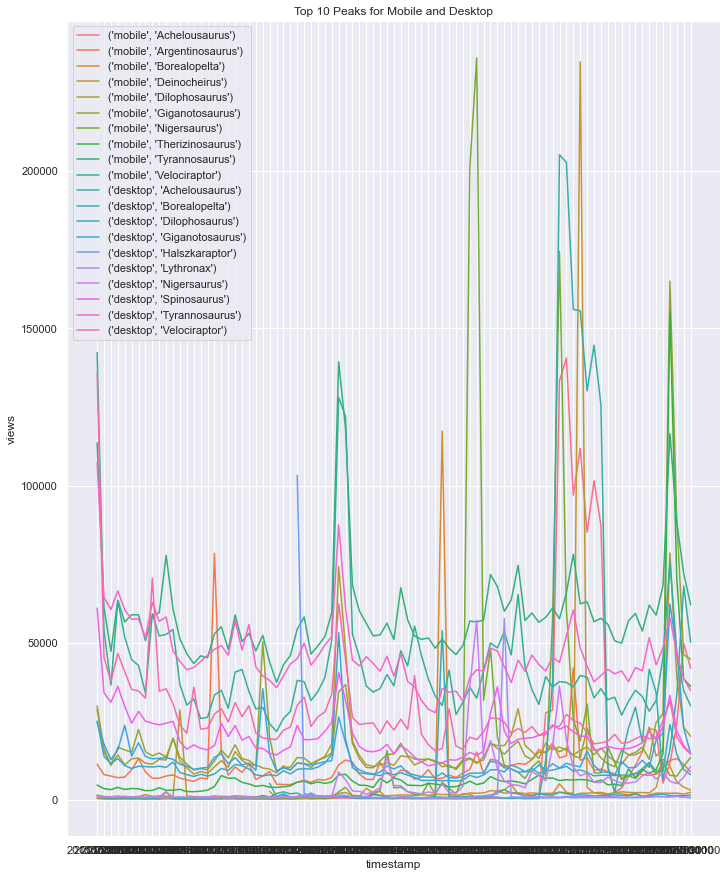

In [160]:
### Plotting 

sns.set(rc = {'figure.figsize': (11.7,15)})

top_10_peak_plot = sns.lineplot(data = desktop_mobile_top_all_time_df,x = 'timestamp', y = 'views' , 
                                hue = desktop_mobile_top_all_time_df[['access', 'article']].apply(tuple, axis =1)).set_title('Top 10 Peaks for Mobile and Desktop')


top_10_peak_plot = top_10_peak_plot.get_figure()

top_10_peak_plot.savefig(os.path.join('.','graphs', 'Top_10_Peaks_Mobile_Desktop.png'))

In [164]:
### Graph 3: Fewest Months of Data

####### This plot shows the pages that have the fewest months of available data for mobile and desktop

## We will again group these by article and now use size() to count the # of rows for each group
mobile_list_2 = list(mobile_dataframe_all.groupby('article').size().to_frame("months_cnt").reset_index()
                    .sort_values('months_cnt')[:10]['article'])

desktop_list_2 = list(desktop_dataframe_all.groupby('article').size().to_frame('months_cnt').reset_index()
                      .sort_values('months_cnt')[:10]['article'])


mobile_top10_fewest = mobile_dataframe_all[mobile_dataframe_all['article'].isin(mobile_list_2)]
mobile_top10_fewest['access'] = 'mobile' # just changing the word 'combined mobile' to 'mobile'
desktop_top10_fewest = desktop_dataframe_all[desktop_dataframe_all['article'].isin(desktop_list_2)]

/var/folders/jx/zmvdb9015r5cmfk2_vpyps180000gn/T/ipykernel_62736/2851885297.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  mobile_top10_fewest['access'] = 'mobile'


In [165]:
mobile_list_2

['Elemgasem',
 'Tuebingosaurus',
 'Jakapil',
 'Perijasaurus',
 'Mbiresaurus',
 'Bisticeratops',
 'Iyuku',
 'Paralitherizinosaurus',
 'Dzharaonyx',
 'Bashanosaurus']

In [167]:
desktop_list_2

['Elemgasem',
 'Tuebingosaurus',
 'Jakapil',
 'Perijasaurus',
 'Mbiresaurus',
 'Bisticeratops',
 'Iyuku',
 'Paralitherizinosaurus',
 'Dzharaonyx',
 'Bashanosaurus']

In [169]:
desktop_mobile_top10_fewest_df = pd.concat([desktop_top10_fewest, mobile_top10_fewest])

In [170]:
desktop_mobile_top10_fewest_df

,project,article,granularity,timestamp,access,agent,views
15120,en.wikipedia,Bashanosaurus,monthly,2022030100,desktop,user,2351
15121,en.wikipedia,Bashanosaurus,monthly,2022040100,desktop,user,438
15122,en.wikipedia,Bashanosaurus,monthly,2022050100,desktop,user,385
15123,en.wikipedia,Bashanosaurus,monthly,2022060100,desktop,user,379
15124,en.wikipedia,Bashanosaurus,monthly,2022070100,desktop,user,307
...,...,...,...,...,...,...,...
74287,en.wikipedia,Paralitherizinosaurus,monthly,2022080100,mobile,user,282
74288,en.wikipedia,Paralitherizinosaurus,monthly,2022090100,mobile,user,213
76438,en.wikipedia,Perijasaurus,monthly,2022080100,mobile,user,1150
76439,en.wikipedia,Perijasaurus,monthly,2022090100,mobile,user,166


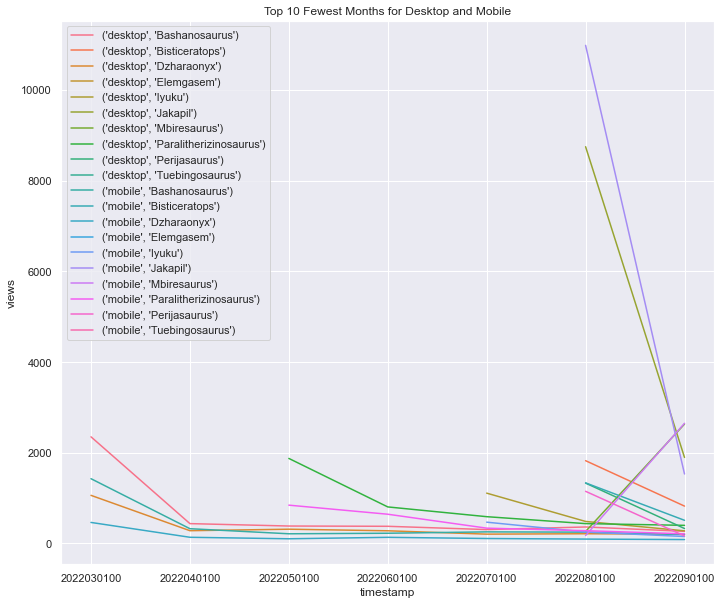

In [173]:
desktop_mobile_top10_fewest_df = desktop_mobile_top10_fewest_df.reset_index()

## Plotting

sns.set(rc={'figure.figsize':(11.7,10)})
top10fewest_plot = sns.lineplot(data=desktop_mobile_top10_fewest_df, x="timestamp", y="views", 
                                hue=desktop_mobile_top10_fewest_df[["access","article"]].apply(tuple, axis=1)).set_title('Top 10 Fewest Months for Desktop and Mobile')
top10fewest_plot = top10fewest_plot.get_figure()
top10fewest_plot.savefig(os.path.join(".","graphs","Top10fewest_plot.png"))
